## Import Library and Load data

In [1]:
#Modifikasi
import warnings
import zipfile
import numpy as np
import pandas as pd
from pathlib import Path
pd.set_option('display.max_columns', 100)

#Visualisasi
import seaborn as sns
import matplotlib.pyplot as plt
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly_express as px
import plotly.subplots as sp
from statsmodels.graphics.tsaplots import plot_acf
from matplotlib import rcParams

#Perhitungan
import itertools
from statsmodels.formula.api import ols
import statsmodels.api as sm
from geopy.geocoders import Nominatim
from scipy import stats
from statsmodels.tsa.seasonal import seasonal_decompose


#Imputasi
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import SimpleImputer, KNNImputer, IterativeImputer
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression


# Modeling
from sklearn.model_selection import train_test_split,GridSearchCV,RandomizedSearchCV, GroupKFold,KFold, TimeSeriesSplit   
from sklearn.metrics import classification_report, accuracy_score, roc_curve, auc,roc_auc_score, mean_squared_error
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

#Feature Selection
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from mlxtend.feature_selection import SequentialFeatureSelector as SFS

# Feature Importance
from sklearn.ensemble import ExtraTreesClassifier

In [2]:
train = pd.read_csv('Train.csv')
test = pd.read_csv('Test.csv')

## Data Understanding (Train and Test)

In [3]:
train.head()

,ID_Zindi,Date,ID,LAT,LON,Precipitation,LST,AAI,CloudFraction,NO2_strat,NO2_total,NO2_trop,TropopausePressure,GT_NO2
0,ID_ENTGC7,1/1/19,PD01,45.601585,11.903551,0.000000,NaN,0.230527,0.559117,0.000024,0.000117,NaN,14440.82126,31.0
1,ID_8JCCXC,1/1/19,PD04,45.371005,11.840830,3.047342,NaN,-0.074006,0.869309,0.000024,0.000127,NaN,14441.79815,42.0
2,ID_V3136Z,1/1/19,RO01,45.045825,12.060869,0.000000,NaN,0.024470,0.674160,0.000024,0.000086,NaN,14437.38294,31.0
3,ID_KRVZDJ,1/1/19,RO02,45.104075,11.553241,1.200467,NaN,-0.010442,0.920054,0.000024,0.000124,NaN,14440.83831,30.0
4,ID_PR351A,1/1/19,RO03,45.038758,11.790152,1.274564,NaN,-0.176178,0.747464,0.000024,0.000116,NaN,14438.79037,58.0


In [4]:
train.info(),train.shape

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 86584 entries, 0 to 86583
Data columns (total 14 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   ID_Zindi            86584 non-null  object 
 1   Date                86584 non-null  object 
 2   ID                  86584 non-null  object 
 3   LAT                 86584 non-null  float64
 4   LON                 86584 non-null  float64
 5   Precipitation       86584 non-null  float64
 6   LST                 46798 non-null  float64
 7   AAI                 73709 non-null  float64
 8   CloudFraction       73709 non-null  float64
 9   NO2_strat           73709 non-null  float64
 10  NO2_total           73709 non-null  float64
 11  NO2_trop            51111 non-null  float64
 12  TropopausePressure  73709 non-null  float64
 13  GT_NO2              82051 non-null  float64
dtypes: float64(11), object(3)
memory usage: 9.2+ MB


(None, (86584, 14))

In [5]:
train.isna().sum()

ID_Zindi                  0
Date                      0
ID                        0
LAT                       0
LON                       0
Precipitation             0
LST                   39786
AAI                   12875
CloudFraction         12875
NO2_strat             12875
NO2_total             12875
NO2_trop              35473
TropopausePressure    12875
GT_NO2                 4533
dtype: int64

## Data Cleaning

In [6]:
train['Date'] = pd.to_datetime(train['Date'], dayfirst=True, errors='coerce')

# 3. Menetapkan kolom Date sebagai index
train.set_index('Date', inplace=True)

C:\Users\booma\AppData\Local\Temp\ipykernel_10076\1795112415.py:1: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



# EDA

1. Precipitation
    - Description: Amount of precipitation (rainfall or equivalent) measured at the location.
    - Type: Continuous (float64).
    - Units: Likely millimeters (mm) or equivalent.
    - Purpose: A critical feature for environmental and climate modeling.

2. LST (Land Surface Temperature)
    - Description: Measured temperature of the Earth's surface at the location.
    - Type: Continuous (float64).
    - Units: Likely degrees Celsius or Kelvin.
    - Purpose: Used in studies of heat distribution, climate, or agriculture.

3. AAI (Absorbing Aerosol Index)
    - Description: Indicates the presence of aerosols (e.g., dust, smoke) in the atmosphere.
    - Type: Continuous (float64).
    - Range: Positive values indicate absorbing aerosols; negative or near-zero values may indicate clear conditions.
    - Purpose: Relevant for air quality analysis and environmental studies.

4. CloudFraction
    - Description: Fractional coverage of clouds in the observed area.
    - Type: Continuous (float64).
    - Range: 0 (clear) to 1 (completely overcast).
    - Purpose: Used in weather and climate modeling.

5. NO2_strat (Stratospheric NO₂)
    - Description: Concentration of nitrogen dioxide in the stratosphere.
    - Type: Continuous (float64).
    - Units: Likely micrograms per cubic meter (µg/m³).
    - Purpose: Provides insights into atmospheric chemistry and pollution sources.

6. NO2_total (Total NO₂)
    - Description: Total nitrogen dioxide concentration in the atmosphere.
    - Type: Continuous (float64).
    - Purpose: Useful for assessing air pollution levels.

7. NO2_trop (Tropospheric NO₂)
    - Description: Concentration of nitrogen dioxide in the troposphere.
    - Type: Continuous (float64).
    - Purpose: Indicates near-surface pollution and human activity impact.

8. TropopausePressure
    - Description: Pressure at the tropopause (the boundary between the troposphere and stratosphere).
    - Type: Continuous (float64).
    - Units: Likely hectopascals (hPa).
    - Purpose: Provides insights into atmospheric dynamics and weather.

9. GT_NO2 (Ground Truth NO₂)
    - Description: Ground-level concentration of nitrogen dioxide.
    - Type: Continuous (float64).
    - Purpose: Used as a benchmark or target value for validation and modeling.


In [7]:
colToVisual = ['Precipitation', 'LST', 'AAI', 'CloudFraction', 'NO2_strat', 'NO2_total', 'TropopausePressure', 'GT_NO2', 'NO2_trop']

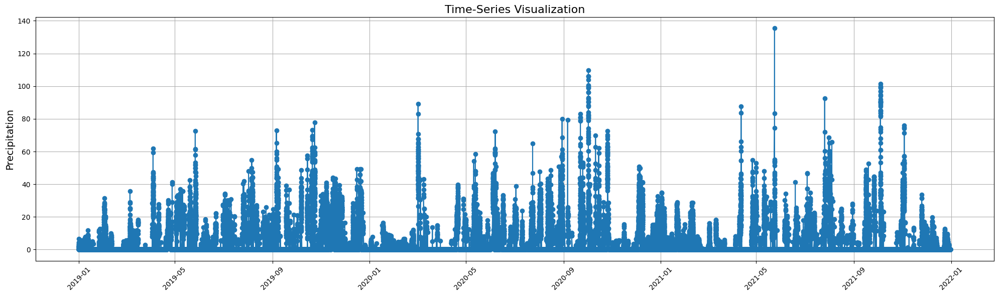

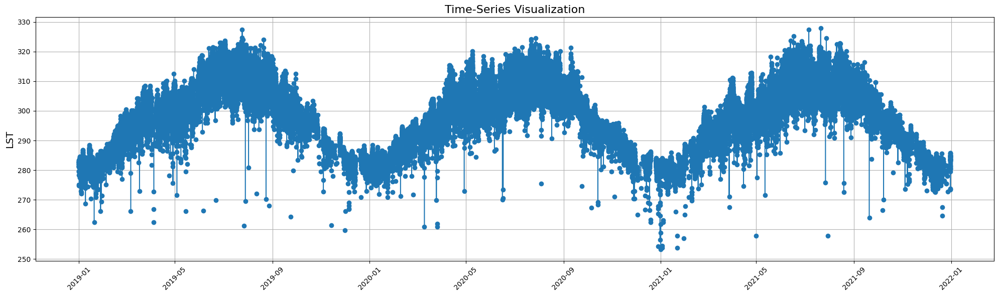

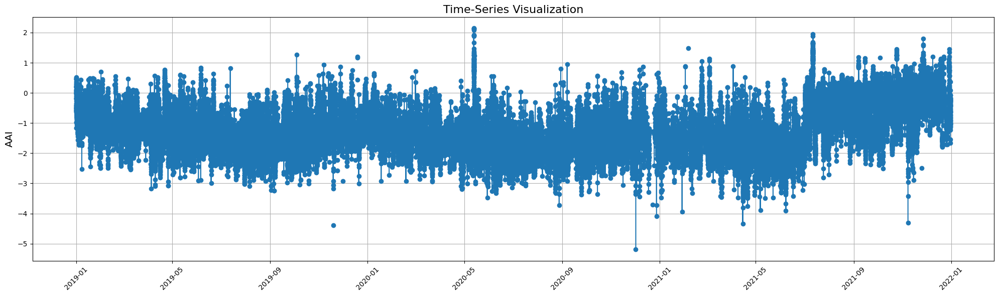

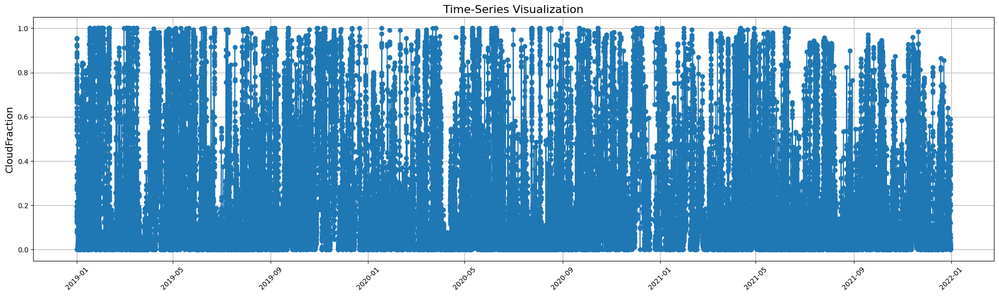

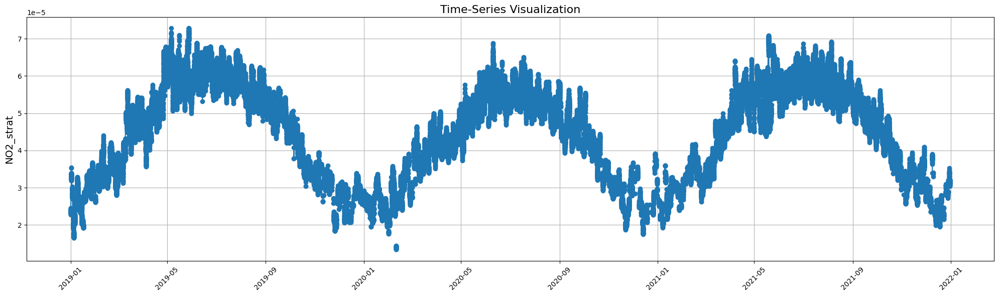

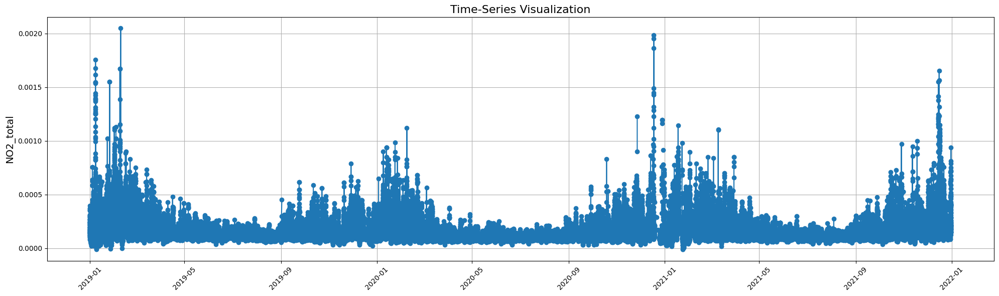

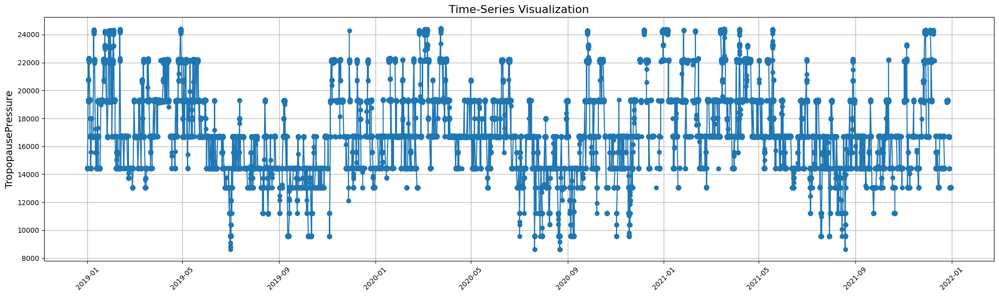

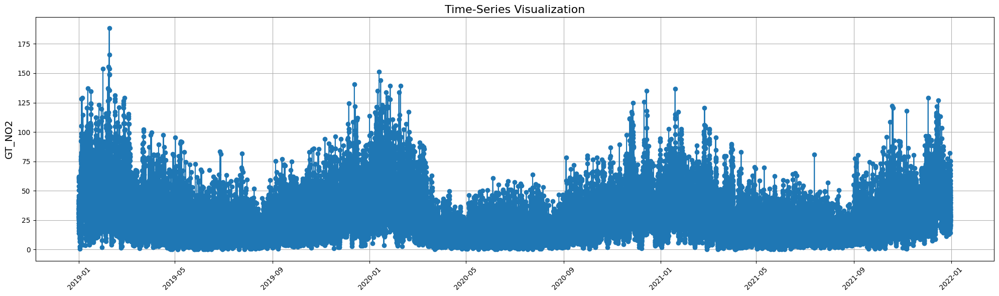

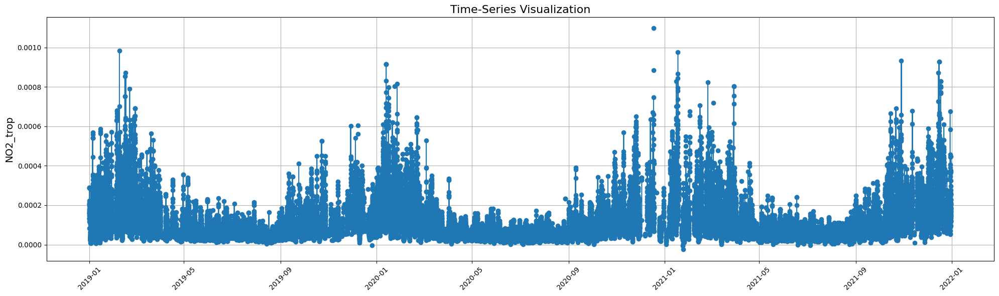

In [8]:
for col in colToVisual:
    plt.figure(figsize=(20, 6))
    plt.plot(train.index, train[col], marker='o')
    plt.title('Time-Series Visualization', fontsize=16)
    plt.ylabel(f'{col}', fontsize=14)
    plt.grid(True)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


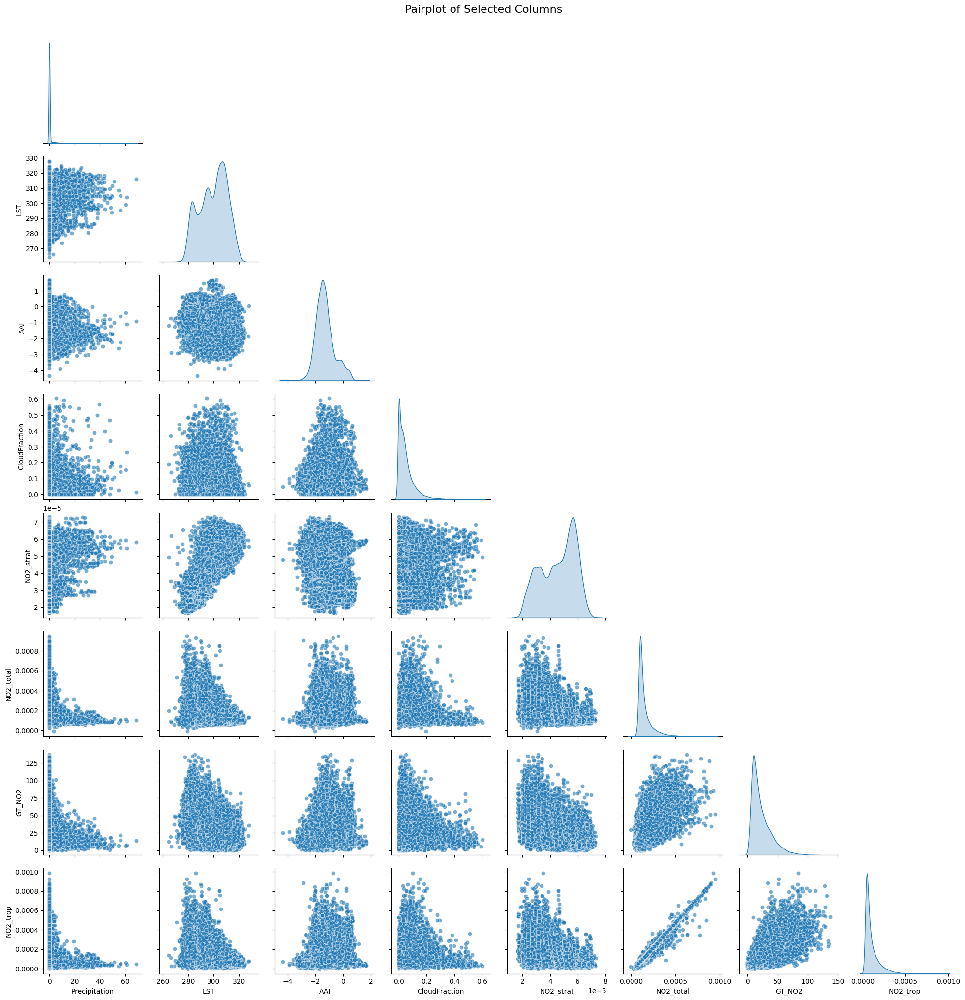

In [9]:
colToVisual = ['Precipitation', 'LST', 'AAI', 'CloudFraction', 'NO2_strat', 'NO2_total', 'GT_NO2', 'NO2_trop']
# Pilih subset data berdasarkan 'colToVisual'
data_to_plot = train[colToVisual]
data_to_plot = train[colToVisual].dropna()  # Hapus baris dengan nilai NaN

# Buat pairplot
sns.pairplot(data_to_plot, diag_kind='kde', corner=True, plot_kws={'alpha': 0.6})

# Tampilkan plot
plt.suptitle('Pairplot of Selected Columns', y=1.02, fontsize=16)
plt.show()

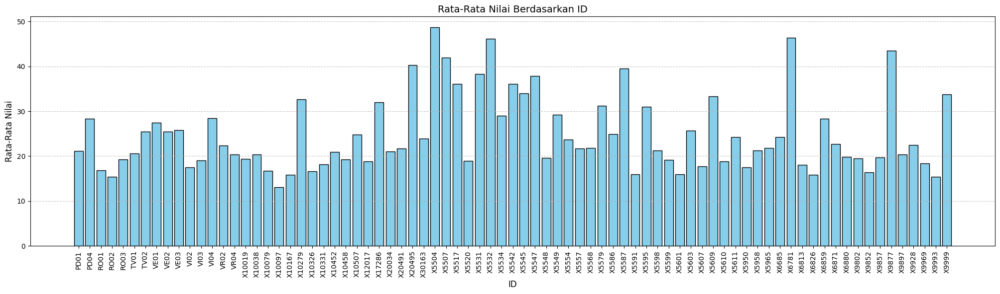

In [10]:
data = pd.read_csv('Train.csv')
mean_values = data.groupby('ID')['GT_NO2'].mean().reset_index()
plt.figure(figsize=(25, 6))
plt.bar(mean_values['ID'], mean_values['GT_NO2'], color='skyblue', edgecolor='black')

# Penyesuaian visualisasi  
plt.title('Rata-Rata Nilai Berdasarkan ID', fontsize=14)
plt.xlabel('ID', fontsize= 12)
plt.ylabel('Rata-Rata Nilai', fontsize=12)
plt.xticks(mean_values['ID'], fontsize=10,rotation=90)
plt.yticks(fontsize=10)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Menampilkan plot
plt.show()

#### Check range normal valur for all columns

In [11]:
df_filtered = data.drop(['LAT', 'LON', 'ID_Zindi', 'Date', 'ID'], axis=1)

# Tentukan ukuran grid
num_columns = len(df_filtered.columns)
num_rows = int(np.ceil(num_columns / 3))  # Membuat 3 kolom per baris

# Siapkan subplot
fig = sp.make_subplots(rows=num_rows, cols=3, subplot_titles=[f'Distribusi {col}' for col in df_filtered.columns])

# Looping untuk setiap kolom dan tambahkan histogram ke subplot
for i, col in enumerate(df_filtered.columns):
    row = i // 3 + 1
    col_pos = i % 3 + 1
    hist_data = df_filtered[col].dropna()  # Hilangkan NaN untuk histogram
    fig.add_trace(
        go.Histogram(x=hist_data, nbinsx=30, name=col, opacity=0.75),
        row=row,
        col=col_pos
    )

# Menyesuaikan tata letak
fig.update_layout(
    height=300 * num_rows,
    width=1000,
    showlegend=False,
    title_text='Distribusi Histogram Kolom',
    title_x=0.5,
)

fig.update_xaxes(title_text="Nilai")
fig.update_yaxes(title_text="Frekuensi")

fig.show()

## Imputasi

In [14]:
df = train.copy()
df.drop(columns=['ID_Zindi','ID'],inplace=True)
cols_to_impute_rf = ['AAI', 'CloudFraction','LST', 'NO2_trop', 'NO2_strat', 'NO2_total', 'TropopausePressure']
# Loop untuk mengimputasi tiap kolom dalam cols_to_impute_rf
for col in cols_to_impute_rf:
    if df[col].isna().sum() > 0:  # Cek apakah ada nilai NaN pada kolom
        non_missing_data = df[df[col].notna()]  # Data tanpa nilai NaN untuk training
        X_train = non_missing_data.drop(columns=[col, 'LAT', 'LON'])  # Fitur training tanpa kolom target
        y_train = non_missing_data[col]  # Target untuk training
        
        # Inisiasi Random Forest Regressor dan training
        rf_imputer = RandomForestRegressor(n_estimators=100, random_state=42)
        rf_imputer.fit(X_train, y_train)
        
        # Melakukan prediksi untuk mengisi nilai NaN
        # Pastikan hanya menghapus kolom yang digunakan pada model yang telah dilatih
        X_pred = df[df[col].isna()].drop(columns=[col, 'LAT', 'LON'])
        df.loc[df[col].isna(), col] = rf_imputer.predict(X_pred)

# Imputasi untuk kolom dengan missing data sedikit (Mean Imputation)
cols_to_impute_mean = ['GT_NO2']
mean_imputer = SimpleImputer(strategy='mean')
df[cols_to_impute_mean] = mean_imputer.fit_transform(df[cols_to_impute_mean])

# Imputasi untuk kolom berbasis time series (Misalnya Precipitation)
# Time series imputation using Iterative Imputer (Multiple Imputation)
time_series_cols = ['Precipitation']
time_series_imputer = IterativeImputer(random_state=42)
df[time_series_cols] = time_series_imputer.fit_transform(df[time_series_cols])

# Feature Engineering

In [27]:
# df.to_csv('train_imputed_with_rf_regressor.csv', index=False)
data = pd.read_csv('train_imputed_with_rf_regressor.csv')
data.drop(['LAT','LON'],axis=1,inplace=True)

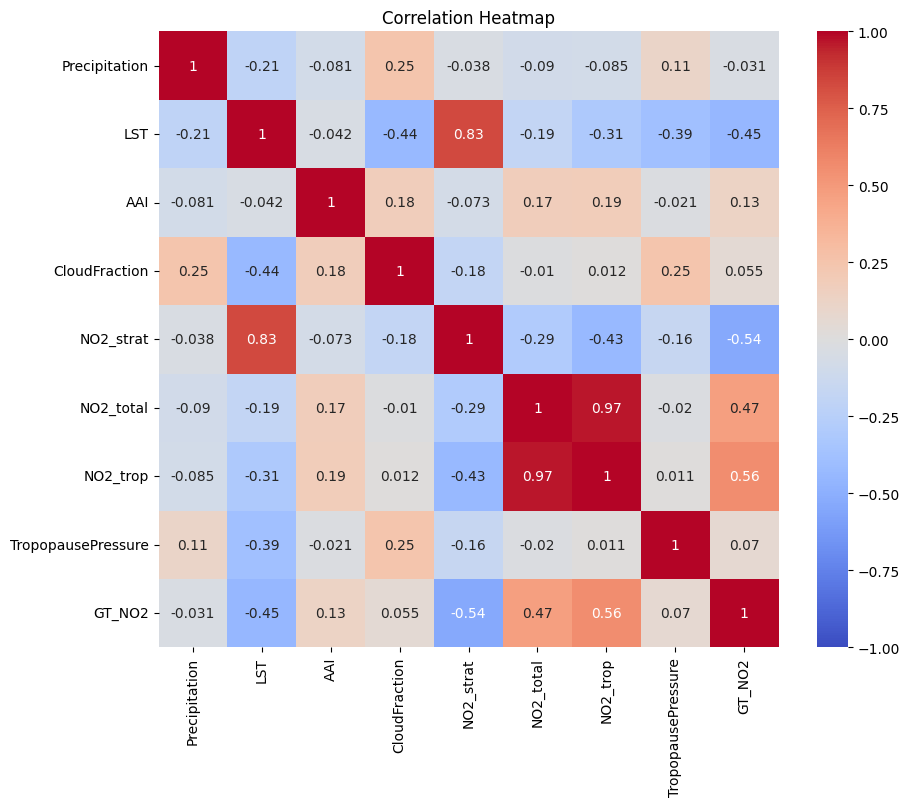

In [28]:
corr = data.corr()
fig, ax = plt.subplots(figsize=(10, 8))
sns.heatmap(corr, annot=True, cmap='coolwarm', ax=ax,vmax=1,vmin=-1)
ax.set_title('Correlation Heatmap')
plt.show()

In [17]:
kmeans = KMeans(n_clusters=3)
data['Kmeans'] = kmeans.fit_predict(data[['NO2_strat', 'NO2_total', 'NO2_trop']])

In [18]:
scaler = StandardScaler()
data['TropopausePressure'] = scaler.fit_transform(data[['TropopausePressure']])

In [19]:
from sklearn.preprocessing import PolynomialFeatures

# Misalnya, data berisi kolom 'Precipitation', 'LST', 'AAI'
poly = PolynomialFeatures(degree=2)

# Menerapkan transformasi polinomial pada kolom-kolom yang ditentukan
poly_features = poly.fit_transform(data[['Precipitation', 'LST', 'AAI']])

# Membuat DataFrame baru dengan nama kolom yang sesuai
poly_feature_columns = poly.get_feature_names_out(['Precipitation', 'LST', 'AAI'])

# Menggabungkan hasilnya dengan data asli (jika perlu)
poly_data = pd.DataFrame(poly_features, columns=poly_feature_columns)
poly_data.drop(['1','Precipitation','LST','AAI',],axis=1,inplace=True)

In [20]:
result = pd.concat([data, poly_data], axis=1)


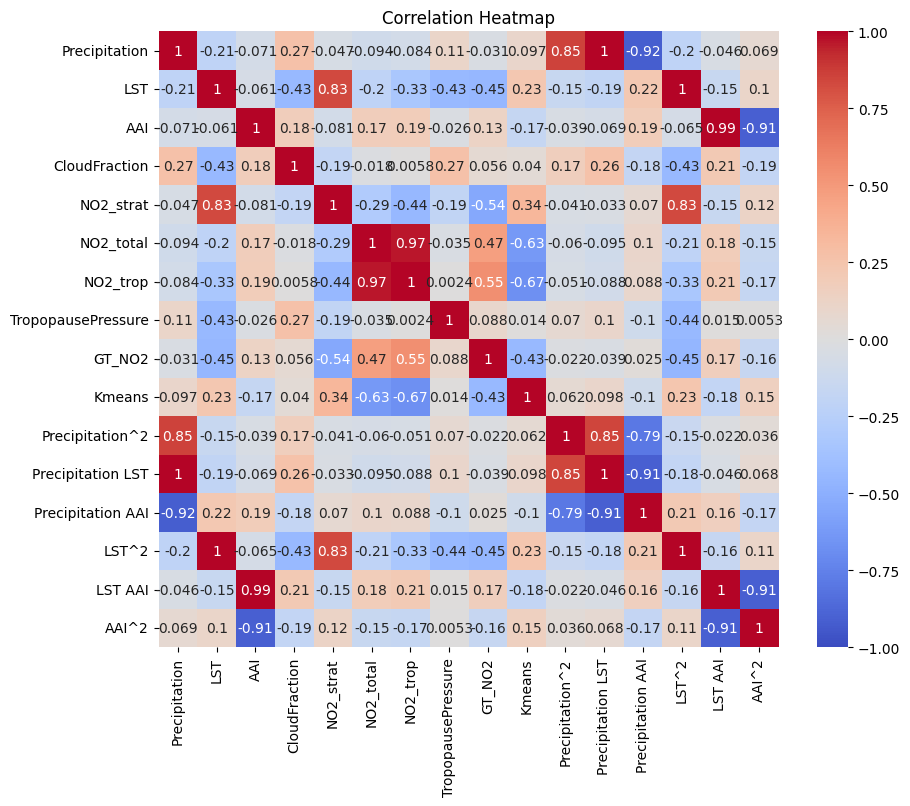

In [21]:
corr = result.corr()
fig, ax = plt.subplots(figsize=(10, 8))
sns.heatmap(corr, annot=True, cmap='coolwarm', ax=ax,vmax=1,vmin=-1)
ax.set_title('Correlation Heatmap')
plt.show()